In [21]:
import pandas as pd
import geopandas as gpd
import PIL
import io
import mapclassify
%matplotlib inline

In [23]:
#Loading data to notebook
veri = pd.read_csv('Data/time_series_covid19_confirmed_global.csv')

In [3]:
veri

,Province/State,Country/Region,Lat,Long,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,1/27/2020,...,3/4/2021,3/5/2021,3/6/2021,3/7/2021,3/8/2021,3/9/2021,3/10/2021,3/11/2021,3/12/2021,3/13/2021
0,NaN,Afghanistan,33.939110,67.709953,0,0,0,0,0,0,...,55775,55827,55840,55847,55876,55876,55894,55917,55959,55959
1,NaN,Albania,41.153300,20.168300,0,0,0,0,0,0,...,110521,111301,112078,112897,113580,114209,114840,115442,116123,116821
2,NaN,Algeria,28.033900,1.659600,0,0,0,0,0,0,...,113761,113948,114104,114234,114382,114543,114681,114851,115008,115143
3,NaN,Andorra,42.506300,1.521800,0,0,0,0,0,0,...,10976,10998,11019,11042,11069,11089,11130,11130,11199,11228
4,NaN,Angola,-11.202700,17.873900,0,0,0,0,0,0,...,20981,21026,21055,21086,21108,21114,21161,21205,21265,21323
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
269,NaN,Vietnam,14.058324,108.277199,0,2,2,2,2,2,...,2488,2494,2501,2512,2524,2526,2529,2533,2550,2553
270,NaN,West Bank and Gaza,31.952200,35.233200,0,0,0,0,0,0,...,191203,193029,194548,196812,198554,200382,202378,203669,205652,207436
271,NaN,Yemen,15.552727,48.516388,0,0,0,0,0,0,...,2375,2411,2444,2473,2545,2586,2627,2667,2729,2771
272,NaN,Zambia,-13.133897,27.849332,0,0,0,0,0,0,...,80687,81341,82011,82421,82655,82897,83333,83913,84240,84474


## Pre-processing

In [4]:
#grouping data
veri = veri.groupby('Country/Region').sum()
veri

,Lat,Long,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,1/27/2020,1/28/2020,1/29/2020,...,3/4/2021,3/5/2021,3/6/2021,3/7/2021,3/8/2021,3/9/2021,3/10/2021,3/11/2021,3/12/2021,3/13/2021
Country/Region,,,,,,,,,,,,,,,,,,,,,
Afghanistan,33.939110,67.709953,0,0,0,0,0,0,0,0,...,55775,55827,55840,55847,55876,55876,55894,55917,55959,55959
Albania,41.153300,20.168300,0,0,0,0,0,0,0,0,...,110521,111301,112078,112897,113580,114209,114840,115442,116123,116821
Algeria,28.033900,1.659600,0,0,0,0,0,0,0,0,...,113761,113948,114104,114234,114382,114543,114681,114851,115008,115143
Andorra,42.506300,1.521800,0,0,0,0,0,0,0,0,...,10976,10998,11019,11042,11069,11089,11130,11130,11199,11228
Angola,-11.202700,17.873900,0,0,0,0,0,0,0,0,...,20981,21026,21055,21086,21108,21114,21161,21205,21265,21323
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Vietnam,14.058324,108.277199,0,2,2,2,2,2,2,2,...,2488,2494,2501,2512,2524,2526,2529,2533,2550,2553
West Bank and Gaza,31.952200,35.233200,0,0,0,0,0,0,0,0,...,191203,193029,194548,196812,198554,200382,202378,203669,205652,207436
Yemen,15.552727,48.516388,0,0,0,0,0,0,0,0,...,2375,2411,2444,2473,2545,2586,2627,2667,2729,2771


In [5]:
#droping columns
veri = veri.drop(columns=['Lat', 'Long'])

In [6]:
#create transporse of the df
veri_transpored = veri.T
veri_transpored

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,...,United Kingdom,Uruguay,Uzbekistan,Vanuatu,Venezuela,Vietnam,West Bank and Gaza,Yemen,Zambia,Zimbabwe
1/22/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/23/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
1/24/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
1/25/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
1/26/2020,0,0,0,0,0,0,0,0,4,0,...,0,0,0,0,0,2,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3/9/2021,55876,114209,114543,11089,21114,862,2162001,175198,29074,479391,...,4241858,65527,80247,3,143321,2526,200382,2586,82897,36321
3/10/2021,55894,114840,114681,11130,21161,882,2169694,175538,29090,481919,...,4247879,66484,80268,3,143321,2529,202378,2627,83333,36341
3/11/2021,55917,115442,114851,11130,21205,882,2177898,176286,29102,484916,...,4254714,67717,80392,3,144277,2533,203669,2667,83913,36377
3/12/2021,55959,116123,115008,11199,21265,945,2185747,177104,29112,488042,...,4261398,69074,80392,3,144786,2550,205652,2729,84240,36423


### Data visualisation

<AxesSubplot:>

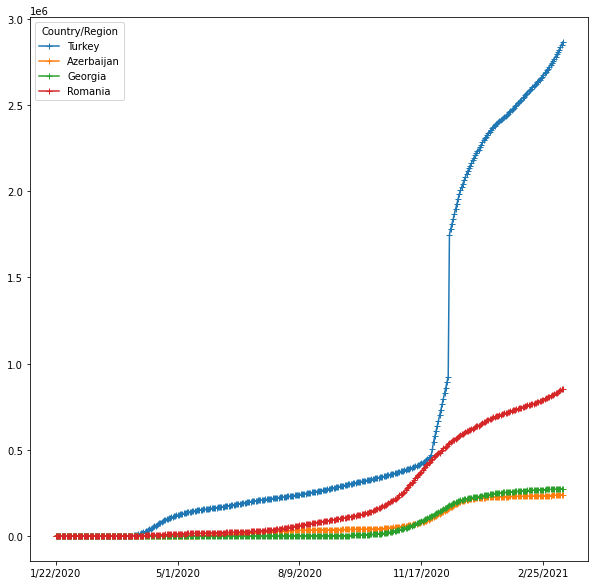

In [7]:
veri_transpored.plot(y=['Turkey', 'Azerbaijan', 'Georgia', 'Romania'], use_index=True,
                     figsize=(10,10), marker='+')


### We are going to load shapefile to notebook with Python geopandas.

In [8]:
ulkeler = gpd.read_file('Data/World_Map.shp')

<AxesSubplot:>

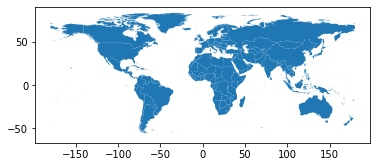

In [9]:
ulkeler.plot()

In [10]:
type(ulkeler)

geopandas.geodataframe.GeoDataFrame

In [11]:
#In order to find differences in both datasets we are going 
#to iterate through each country by it's name
#for index, row in veri.iterrows():
 #   if index not in ulkeler['NAME'].to_list():
#        print(index + ' is not in the list ')
 #   else:
    #    pass#

In [12]:
ulkeler.replace('Viet Nam', 'Vietnam', inplace=True)
ulkeler.replace('Brunei Darussalam', 'Brunei', inplace=True)
ulkeler.replace('Cape Verde', 'Cabo Verde ', inplace=True)
ulkeler.replace('Democratic Republic of Congo', 'Congo(Kinshasa)', inplace=True)
ulkeler.replace('Congo ', 'Congo(Brazzaville)', inplace=True)
ulkeler.replace('Czech Republic', 'Czechia', inplace=True)
ulkeler.replace('Swaziland ', 'Eswatini', inplace=True)
ulkeler.replace('Iran (Islamic Republic of)', 'Iran', inplace=True)
ulkeler.replace('Korea Republic of', 'Korea South', inplace=True)
ulkeler.replace("Lao People's Democratic Republic" , 'Laos', inplace=True) 
ulkeler.replace('Libyan Arab Jamahiyira', 'Libya', inplace=True)
ulkeler.replace('Republic of Moldova', 'Moldova', inplace=True)
ulkeler.replace('The  former Yugoslov Republic of Macedonia', 'North Macedonia', inplace=True)
ulkeler.replace('Syrian Arab Republic', 'Syria', inplace=True) 
ulkeler.replace('Taiwan  ', 'Taiwan*', inplace=True)
ulkeler.replace('United Republic of Tanzania', 'Tanzania', inplace=True) 
ulkeler.replace('United States ', 'US', inplace=True)
ulkeler.replace('Palestine ', 'West Bank and Gaza', inplace=True) 

In [13]:
#joining covid dataset with our spatial data
merge = ulkeler.join(veri, on='NAME', how='right')

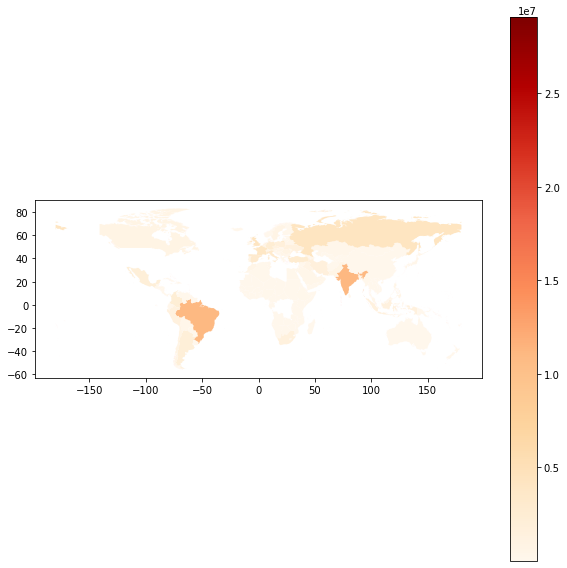

In [14]:
#plotting them
ax = merge.plot(column='3/7/2021', cmap = 'OrRd', figsize = (10,10), legend = True, linewidth=0.5)
#merge.columns

In [16]:
type(merge.columns)

pandas.core.indexes.base.Index

In [17]:
merge.columns.to_list()[1]

'geometry'

In [18]:
len(merge.columns.to_list())

419

C:\Users\User\anaconda3\envs\GIS\lib\site-packages\geopandas\plotting.py:589: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=figsize)


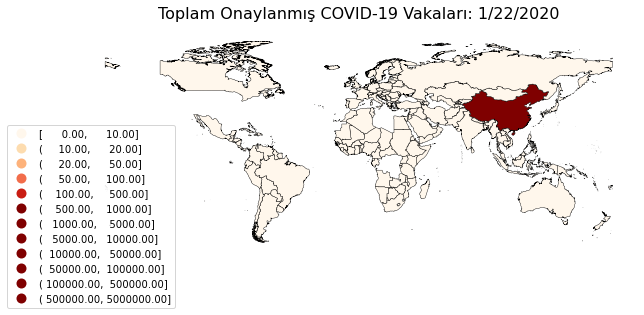

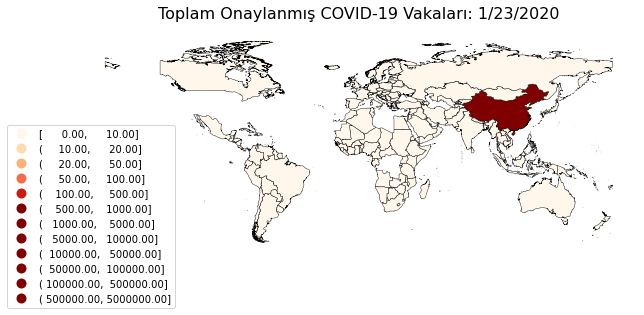

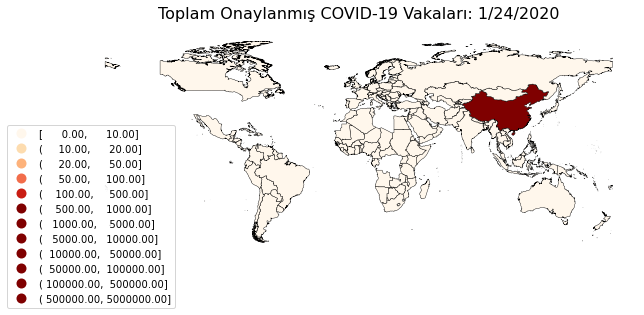

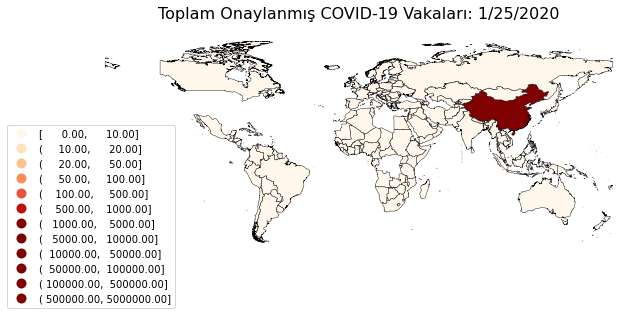

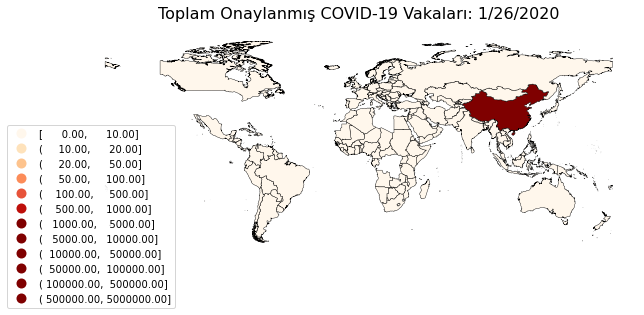

...

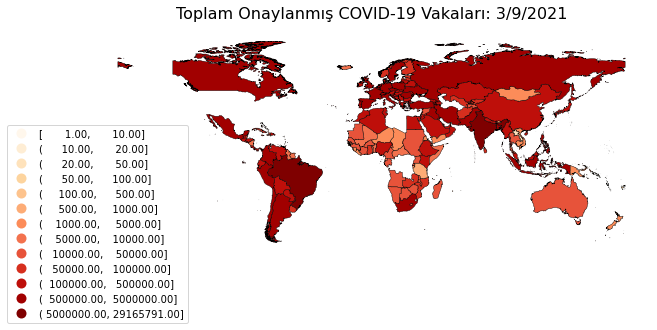

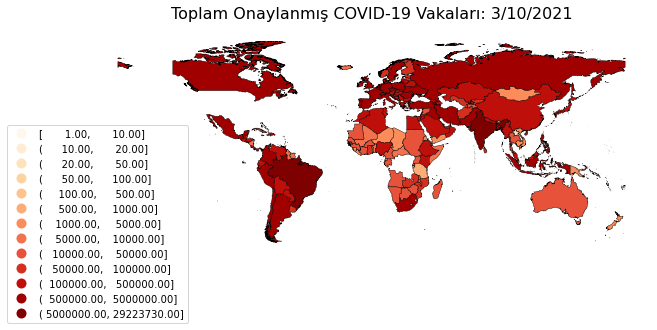

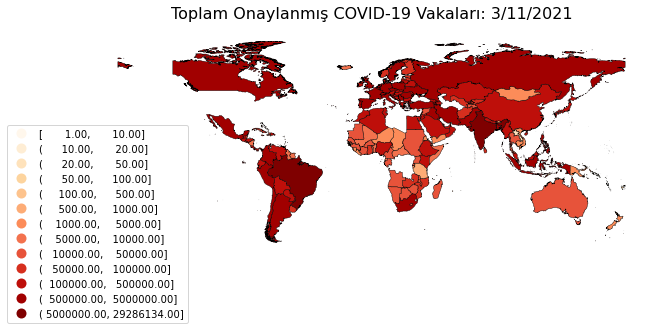

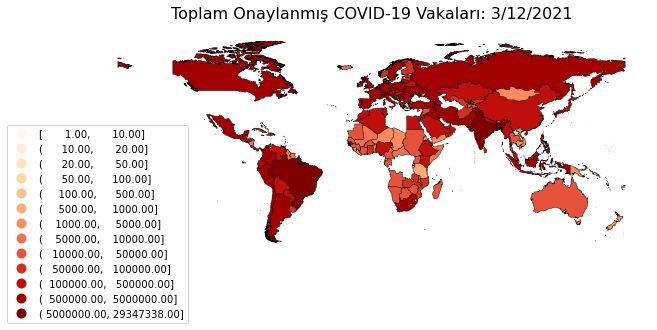

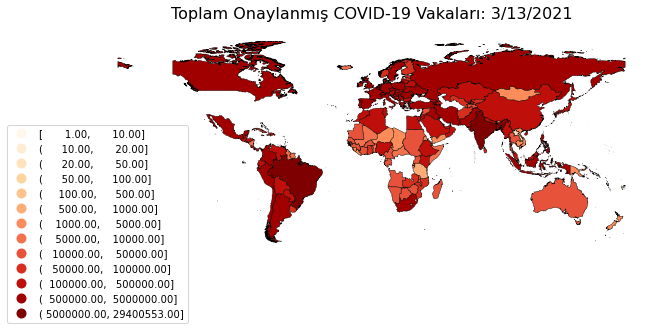

In [19]:
image_frames = []

for dates in merge.columns.to_list()[2:419]:
    
    ax = merge.plot(column = dates, 
                cmap = 'OrRd', 
                figsize = (10,10), 
                legend = True, 
                scheme = 'user_defined', 
                edgecolor = 'black',
                classification_kwds = {'bins':[10, 20, 50, 100, 500, 1000, 5000, 10000, 
                                               50000, 100000, 500000, 5000000]}, 
                linewidth=0.4)
    #add title
    ax.set_title('Toplam Onaylanmış COVID-19 Vakaları: ' + dates, fontdict=
            {'fontsize':16}, pad = 12.5)
    #remove the axis
    ax.set_axis_off()
    #move the legend
    ax.get_legend().set_bbox_to_anchor((0.18, 0.6))
      
    img = ax.get_figure()
    
    f = io.BytesIO()
    img.savefig(f, format = 'png', bbox_inches = 'tight')
    f.seek(0)
    image_frames.append(PIL.Image.open(f))
    
    
#create gif animation

image_frames[0].save('Dynamic COVID-19 Map.gif', format = 'GIF',
                   append_images = image_frames[1:],
                   save_all = True, duration =  250,
                   loop = 1 )
   
f.close()
    
    
    
    
    
    